<a href="https://colab.research.google.com/github/harshitraj21/Animal-classification/blob/main/Animal_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!unzip 'drive/MyDrive/Animals/animals.zip' -d 'drive/MyDrive/Animals/'

Streaming output truncated to the last 5000 lines.
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MVQChNQpHiMZEVMPehrvoAHaE6.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MVdIFDAFpNyK_XCpwkDIWgHaFj.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MYY_8k5AHqMJwTCNXfH6rwHaFj.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MZEVXuoMsATG8u_UuTQ6hAHaE8.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MZg0tznDRE95AMfyuutuYAHaE6.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-M_r9DkR2X5gP0P5-z8wPYQHaE7.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-M_xDUSzjlF3-w9XHCm93cgHaFF.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MbI4-bMyutRX3X382IAVcQAAAA.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MbMksZdD7gomsC9fd6cpKgHaHJ.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-Md4AMcvjaHcivJqeW06wEwHaFW.jpeg  
  inflating: drive/MyDrive/Animals/raw-img/ragno/OIP-MgCgailkT5XkO1XczzQCngHaLK

# ANIMAL CLASSIFICATION

## This project focuses on building a machine learning model for image classification, specifically targeting the classification of animal images into predefined categories. The dataset used in this project consists of approximately 28,000 medium-quality images, each belonging to one of 10 distinct animal categories.
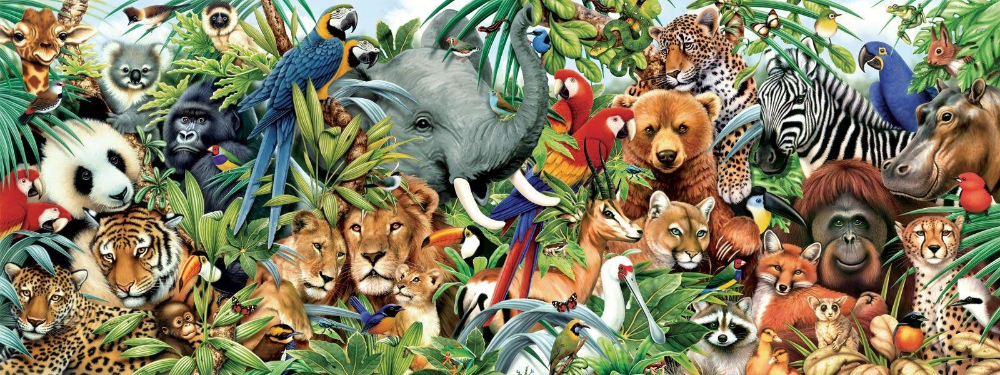
##Dataset Description
### The dataset is well-structured and contains images of the following animal categories:

* Dog
* Cat
* Horse
* Spider
* Butterfly
* Chicken
* Sheep
* Cow
* Squirrel
* Elephant

In [ ]:
# import tensorflow and tensorflow_hub
import tensorflow as tf
import tensorflow_hub as hub
print("Tensorflow version: ", tf.__version__)
print("Tensorflow Hub version: ", hub.__version__)

Tensorflow version:  2.15.0
Tensorflow Hub version:  0.16.1


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

### Just create the labels of the names of animals images we have in the dataset

In [ ]:
root_dir = "drive/MyDrive/Animals/raw-img"
file_paths = []
labels = []

names_of_animals = {
    'cane': 'dog',
    'cavallo': 'horse',
    'elefante': 'elephant',
    'farfalla': 'butterfly',
    'gallina': 'chicken',
    'gatto': 'cat',
    'mucca': 'cow',
    'pecora': 'sheep',
    'scoiattolo': 'squirrel',
    'ragno': 'spider'
}

for subdir, dirs, files in os.walk(root_dir):
  for file in files:
    if file.endswith(('jpg', 'jpeg', 'png')):
      file_path = os.path.join(subdir, file)
      scientific_name = os.path.basename(subdir)
      if scientific_name in names_of_animals:
        label = names_of_animals[scientific_name]
        file_paths.append(file_path)
        labels.append(label)

data = {'file_path': file_paths, 'label': labels}

In [ ]:
df = pd.DataFrame(data)

In [ ]:
df.head()

,file_path,label
0,drive/MyDrive/Animals/raw-img/cane/OIP-oGSGqdB...,dog
1,drive/MyDrive/Animals/raw-img/cane/OIP-hJI41Xt...,dog
2,drive/MyDrive/Animals/raw-img/cane/OIP-i2r1zlq...,dog
3,drive/MyDrive/Animals/raw-img/cane/OIP-itVwY4J...,dog
4,drive/MyDrive/Animals/raw-img/cane/OIP-jMQPG-5...,dog


In [ ]:
path_of_labels = "drive/MyDrive/Animals/animals_image_labels.csv"
df.to_csv(path_of_labels, index = False)

In [ ]:
animal = pd.read_csv("drive/MyDrive/Animals/animals_image_labels.csv")

In [ ]:
animal["label"] = animal["label"].str.capitalize()

In [ ]:
animal.head()

,file_path,label
0,drive/MyDrive/Animals/raw-img/cane/OIP-oGSGqdB...,Dog
1,drive/MyDrive/Animals/raw-img/cane/OIP-hJI41Xt...,Dog
2,drive/MyDrive/Animals/raw-img/cane/OIP-i2r1zlq...,Dog
3,drive/MyDrive/Animals/raw-img/cane/OIP-itVwY4J...,Dog
4,drive/MyDrive/Animals/raw-img/cane/OIP-jMQPG-5...,Dog


In [ ]:
animal["label"].value_counts()

label
Dog          4863
Spider       4821
Chicken      3098
Horse        2623
Butterfly    2112
Cow          1866
Squirrel     1862
Sheep        1820
Cat          1668
Elephant     1446
Name: count, dtype: int64

<Axes: xlabel='label'>

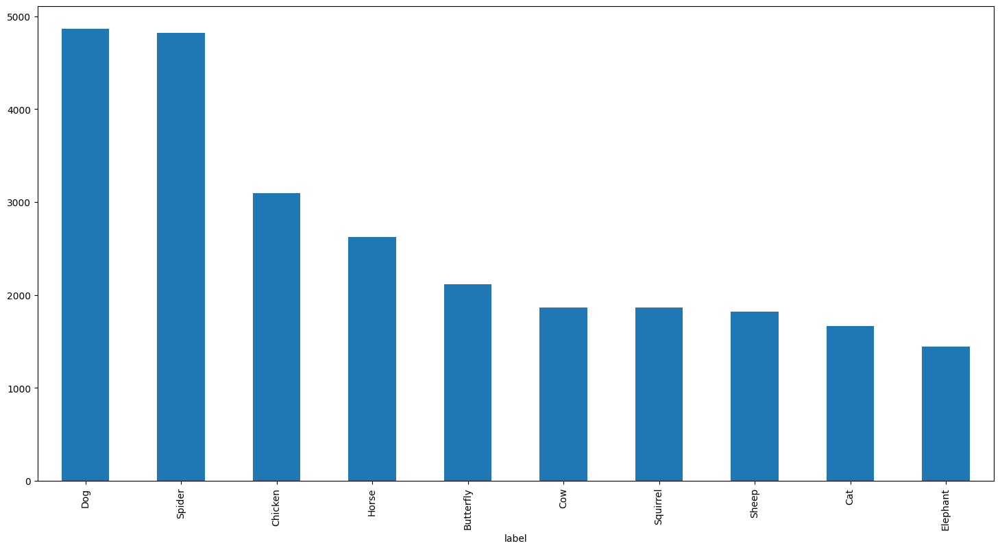

In [ ]:
# Visualize the data we have
animal["label"].value_counts().plot.bar(figsize=(18, 9))

In [ ]:
# See the median number of images in each animal
animal["label"].value_counts().median()

1989.0

In [ ]:
filenames = animal['file_path'].tolist()

In [ ]:
filenames[:10]

['drive/MyDrive/Animals/raw-img/cane/OIP-oGSGqdBez86_n3CzLmA9OQHaE8.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-hJI41XtmlkK6L8DDDJNN5wHaJh.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-i2r1zlq85MV6-mXEZfqi-QHaFI.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-itVwY4JbgR28Adp6YuajsQHaF7.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-jMQPG-5DjJSoACXaQ1wNngHaE7.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-tiCWA2O6GeoJVilUsfcW5AHaHa.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-gOBIeFStdM36ImznYmZzyAHaGT.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-oFv7kJFy6otBlQ1SY-r5ywHaJa.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-ru_1LJHN_hT7erSEuSSsogHaEK.jpeg',
 'drive/MyDrive/Animals/raw-img/cane/OIP-i2eLBINHAlNy8XNkDSHdfQHaGe.jpeg']

In [ ]:
len(filenames)

26179

In [ ]:
labels = animal["label"].to_numpy()
labels, len(labels)

(array(['Dog', 'Dog', 'Dog', ..., 'Squirrel', 'Squirrel', 'Squirrel'],
       dtype=object),
 26179)

In [ ]:
unique_labels = np.unique(labels)
unique_labels, len(unique_labels)

(array(['Butterfly', 'Cat', 'Chicken', 'Cow', 'Dog', 'Elephant', 'Horse',
        'Sheep', 'Spider', 'Squirrel'], dtype=object),
 10)

In [ ]:
boolean_label = [label == unique_labels for label in labels]
boolean_label[:5], len(boolean_label)

([array([False, False, False, False,  True, False, False, False, False,
         False]),
  array([False, False, False, False,  True, False, False, False, False,
         False]),
  array([False, False, False, False,  True, False, False, False, False,
         False]),
  array([False, False, False, False,  True, False, False, False, False,
         False]),
  array([False, False, False, False,  True, False, False, False, False,
         False])],
 26179)

## We will create train, test and validation dataset from the data we have....
### We will divide the dataset in the following proportion:
* Train set -- 80%
* Validation set -- 10%
* Test set -- 10%

In [ ]:
X = filenames
y = boolean_label

In [ ]:
len(X), len(y)

(26179, 26179)

In [ ]:
from sklearn.model_selection import train_test_split
X_train_f, X_temp, y_train_f, y_temp = train_test_split(X, y, test_size = 0.2, stratify = y, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size = 0.5, stratify = y_temp, random_state=42)

X_train, _, y_train, _ = train_test_split(X_train_f, y_train_f, train_size=10000, stratify=[np.argmax(y) for y in y_train_f], random_state=42)

# Create the dataframe for train test val
train_df = pd.DataFrame({'filepath': X_train, 'label': [unique_labels[label.argmax()] for label in y_train]})
valid_df = pd.DataFrame({'filepath': X_val, 'label': [unique_labels[label.argmax()] for label in y_val]})
test_df = pd.DataFrame({'filepath': X_test, 'label': [unique_labels[label.argmax()] for label in y_test]})

In [ ]:
train_df['label'].value_counts()

label
Dog          1857
Spider       1842
Chicken      1183
Horse        1002
Butterfly     807
Cow           713
Squirrel      712
Sheep         695
Cat           637
Elephant      552
Name: count, dtype: int64

In [ ]:
valid_df['label'].value_counts()

label
Dog          486
Spider       482
Chicken      310
Horse        262
Butterfly    211
Cow          187
Squirrel     186
Sheep        182
Cat          167
Elephant     145
Name: count, dtype: int64

In [ ]:
test_df['label'].value_counts()

label
Dog          487
Spider       482
Chicken      310
Horse        263
Butterfly    211
Squirrel     186
Cow          186
Sheep        182
Cat          167
Elephant     144
Name: count, dtype: int64

In [ ]:
len(X_train), len(X_test), len(X_val)

(10000, 2618, 2618)

In [ ]:
len(y_train), len(y_test), len(y_val)

(10000, 2618, 2618)

## Preprocessing Images (turning images into Tensors)
## To preprocess our images into Tensors we're going to write a function which does a few things:

* Take an image filepath as input
* Use TensorFlow to read the file and save it to a variable, image
* Turn our image (a jpg) into Tensors
* Normalize our image (convert color channel values from from 0-255 to 0-1).
* Resize the image to be a shape of (224, 224)
* Return the modified image

In [ ]:
from matplotlib.pyplot import imread
image = imread(filenames[44])
image.shape

(264, 300, 3)

In [ ]:
IMG_SIZE = 224
def process_image(image_path, img_size = IMG_SIZE):
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels = 3)
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, size = [IMG_SIZE, IMG_SIZE])
  return image

In [ ]:
def get_image_label(image_path, label):
  image = process_image(image_path)
  return image, label

### Let's make a function to turn all of our data (X & y) into batches!

In [ ]:
BATCH_SIZE = 32

def create_data_batches(X, y = None, batch_size = BATCH_SIZE, valid_data = False, test_data = False, custom_data = False):
  if test_data:
    print("Creating test data batches.....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))    # filepath, label
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  elif valid_data:
    print("Creating validation data batches.....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  elif custom_data:
    print("Creating custom data batches.....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X)))   # Only filepaths and no labels
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches.....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), tf.constant(y)))
    data = data.shuffle(buffer_size = len(X))
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

In [ ]:
train_data = create_data_batches(X_train, y_train)
test_data = create_data_batches(X_test, y_test, test_data = True)
valid_data = create_data_batches(X_val, y_val, valid_data = True)

Creating training data batches.....
Creating test data batches.....
Creating validation data batches.....


In [ ]:
train_data, test_data, valid_data

(<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.bool, name=None))>,
 <_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.bool, name=None))>,
 <_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.bool, name=None))>)

## Visualizing data batches

In [ ]:
def show_25_images(images, labels):
  plt.figure(figsize=(10, 10))
  for i in range(25):
    ax = plt.subplot(5, 5, i+1)
    plt.imshow(images[i])
    plt.title(unique_labels[np.argmax(labels[i])])
    plt.axis("off")

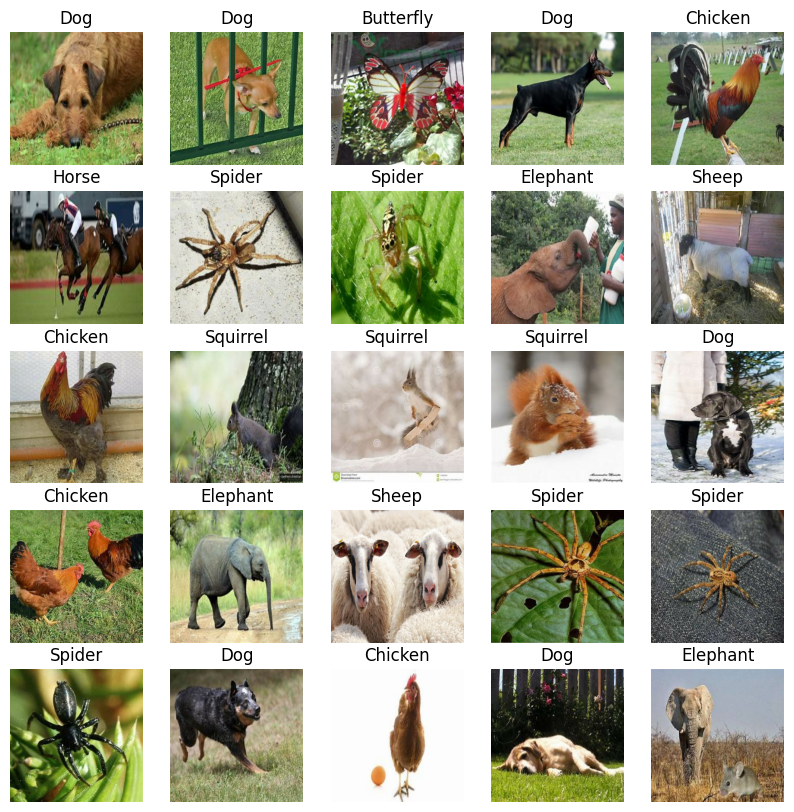

In [ ]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

## Building a model
Before we build a model, there are a few things we need to define:

* The input shape (our images shape, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use from TensorFlow Hub

In [ ]:
IMG_SIZE

224

In [ ]:
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3]    #batch, height, width, channels
OUTPUT_SHAPE = len(unique_labels)
MODEL_URL = "https://www.kaggle.com/models/tensorflow/resnet-50/TensorFlow2/classification/1"

In [ ]:
INPUT_SHAPE, OUTPUT_SHAPE

([None, 224, 224, 3], 10)

In [ ]:
def create_model(input_shape = INPUT_SHAPE, output_shape = OUTPUT_SHAPE, model_url = MODEL_URL):
  print("Building model with", MODEL_URL)
  model = tf.keras.Sequential([
      hub.KerasLayer(MODEL_URL),
      tf.keras.layers.Dense(units=OUTPUT_SHAPE, activation = "softmax")
  ])

  model.compile(
      loss = tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics = ["accuracy"]
  )

  model.build(INPUT_SHAPE)

  return model

In [ ]:
model = create_model()
model.summary()

Building model with https://www.kaggle.com/models/tensorflow/resnet-50/TensorFlow2/classification/1
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              25612201  
                                                                 
 dense (Dense)               (None, 10)                10020     
                                                                 
Total params: 25622221 (97.74 MB)
Trainable params: 10020 (39.14 KB)
Non-trainable params: 25612201 (97.70 MB)
_________________________________________________________________


## Creating callbacks
#### Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress or stop training early if a model stops improving.

#### We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from training for too long.

## TensorBoard Callback
#### To setup a TensorBoard callback, we need to do 3 things:

* Load the TensorBoard notebook extension ✅
* Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's fit() function. ✅
* Visualize our models training logs with the %tensorboard magic function (we'll do this after model training).

In [ ]:
%load_ext tensorboard

In [ ]:
import datetime
def create_tensorboard_callback():
  logdir = os.path.join("drive/MyDrive/Animals/logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early Stopping Callback
Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving.

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor = "val_accuracy", patience = 3)

In [ ]:
NUM_EPOCHS = 8

In [ ]:
def train_model():
  model = create_model()
  tensorboard = create_tensorboard_callback()
  model.fit(x = train_data,
            epochs = NUM_EPOCHS,
            validation_data = valid_data,
            validation_freq = 1,
            callbacks = [tensorboard, early_stopping])
  return model

In [ ]:
model = train_model()

Building model with https://www.kaggle.com/models/tensorflow/resnet-50/TensorFlow2/classification/1
Epoch 1/8
313/313 [==============================] - 2423s 8s/step - loss: 2.1223 - accuracy: 0.5904 - val_loss: 1.9541 - val_accuracy: 0.6982
Epoch 2/8
313/313 [==============================] - 2639s 8s/step - loss: 1.8110 - accuracy: 0.7530 - val_loss: 1.6709 - val_accuracy: 0.7918
Epoch 3/8
313/313 [==============================] - 2672s 9s/step - loss: 1.5523 - accuracy: 0.8120 - val_loss: 1.4350 - val_accuracy: 0.8224
Epoch 4/8
313/313 [==============================] - 3065s 10s/step - loss: 1.3354 - accuracy: 0.8375 - val_loss: 1.2370 - val_accuracy: 0.8499
Epoch 5/8
313/313 [==============================] - 2585s 8s/step - loss: 1.1534 - accuracy: 0.8616 - val_loss: 1.0716 - val_accuracy: 0.8678
Epoch 6/8
313/313 [==============================] - 2499s 8s/step - loss: 1.0015 - accuracy: 0.8810 - val_loss: 0.9342 - val_accuracy: 0.8858
Epoch 7/8
313/313 [======================

### Checking the TensorBoard logs
The TensorBoard magic function (%tensorboard) will access the logs directory we created earlier and visualize its contents.

In [ ]:
%tensorboard --logdir drive/MyDrive/Animals/logs

<IPython.core.display.Javascript object>

### Making and evaluating predictions using a trained model

In [ ]:
import warnings
# Ignore all warnings
warnings.filterwarnings("ignore")

In [ ]:
valid_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.bool, name=None))>

## Make predictions on the validation data (not used to train on)

In [ ]:
predictions = model.predict(valid_data, verbose = 1)
predictions

82/82 [==============================] - 524s 6s/step


array([[0.28991398, 0.06149481, 0.08205001, ..., 0.05884176, 0.12401483,
        0.05031767],
       [0.03175664, 0.02691184, 0.03315472, ..., 0.02706793, 0.04552675,
        0.697359  ],
       [0.05930076, 0.06179017, 0.08860195, ..., 0.09168004, 0.08500323,
        0.05540112],
       ...,
       [0.0674918 , 0.08208474, 0.06887541, ..., 0.09883247, 0.09013508,
        0.04998796],
       [0.03145592, 0.02669346, 0.03267904, ..., 0.02679424, 0.04505131,
        0.70071614],
       [0.04564986, 0.03765687, 0.04853758, ..., 0.4835195 , 0.0685982 ,
        0.03689909]], dtype=float32)

In [ ]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probability):
  return unique_labels[np.argmax(prediction_probability)]

In [ ]:
valid_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.bool, name=None))>

In [ ]:
# Create a function to unbatch a batch dataset
def unbatchify(data):
  images = []
  labels = []
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_labels[np.argmax(label)])
  return images, labels

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n = 1):
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  pred_label = get_pred_label(pred_prob)
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% {}".format(pred_label,
                                       np.max(pred_prob)*100,
                                       true_label),
                                       color = color)

In [ ]:
# Unbatchify the validation data
val_images, val_labels = unbatchify(valid_data)

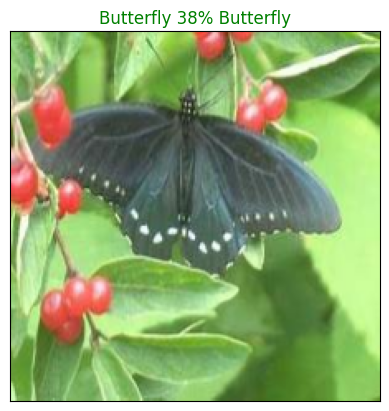

In [ ]:
plot_pred(prediction_probabilities = predictions,
          labels = val_labels,
          images = val_images,
          n=77)

### Now we've got one function to visualize our models top prediction, let's visualize how our model predicted the labels

This function will:

* Take an input of prediction probabilities array and a ground truth array and an integer ✅
* Find the prediction using get_pred_label() ✅
* Find:
Prediction probabilities indexes ✅
Prediction probabilities values ✅
Prediction labels ✅
* Plot all the prediction probability values and labels, coloring the true label green

In [ ]:
def plot_pred_confidence(prediction_probabilities, labels, n=1):
  pred_prob, true_label = prediction_probabilities[n], labels[n]
  prediction_label = get_pred_label(pred_prob)
  prediction_indices = pred_prob.argsort()[::-1]
  prediction_values = pred_prob[prediction_indices]
  prediction_labels = unique_labels[prediction_indices]

  pr_plot = plt.bar(np.arange(len(prediction_labels)), prediction_values, color = "red")
  plt.xticks(np.arange(len(prediction_labels)), labels = prediction_labels, rotation = "vertical")

  if np.isin(true_label, prediction_labels):
    pr_plot[np.argmax(prediction_labels == true_label)].set_color("green")
  else:
    pass

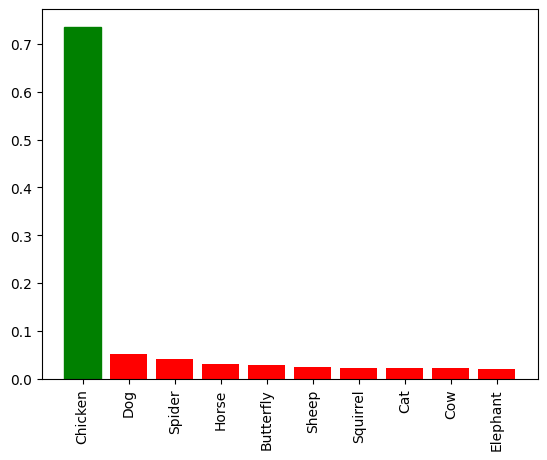

In [ ]:
plot_pred_confidence(prediction_probabilities = predictions, labels = val_labels, n=22)

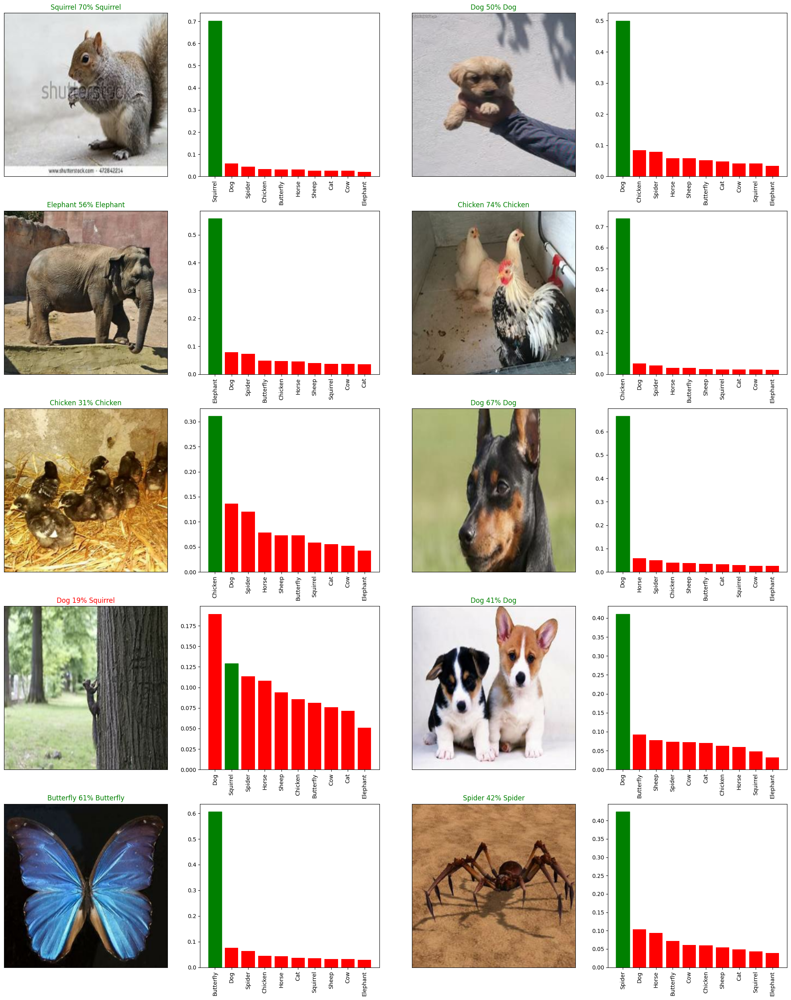

In [ ]:
# Let's check out a few predictions and their different values
multiplier = 150
num_rows = 5
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize = (10*num_cols, 5*num_rows))

for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities = predictions, labels = val_labels, images = val_images, n = i + multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_confidence(prediction_probabilities = predictions, labels = val_labels, n = i + multiplier)

plt.tight_layout(h_pad = 1.0)
plt.show()

## Saving and reloading a trained model

In [ ]:
def save_model(model, suffix = None):
  model_dir = os.path.join("drive/MyDrive/Animals/models", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  model_path = model_dir + "-" + suffix + ".h5"
  print(f"Saving the model to: {model_path}....")
  model.save(model_path)
  return model_path

In [ ]:
def load_model(model_path):
  print(f"Loading the model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects = {"KerasLayer": hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 10000 images
save_model(model, suffix = "10000-images-resnet50-Adam")

Saving the model to: drive/MyDrive/Animals/models/20240628-144459-10000-images-resnet50-Adam.h5....


'drive/MyDrive/Animals/models/20240628-144459-10000-images-resnet50-Adam.h5'

In [ ]:
loaded_10000_img_model = load_model("drive/MyDrive/Animals/models/20240628-144459-10000-images-resnet50-Adam.h5")

Loading the model from: drive/MyDrive/Animals/models/20240628-144459-10000-images-resnet50-Adam.h5


In [ ]:
model.evaluate(valid_data)

82/82 [==============================] - 548s 7s/step - loss: 0.7266 - accuracy: 0.9068


[0.7265832424163818, 0.9067990779876709]

In [ ]:
# Following loaded_10000_img_model will give same result given by above
loaded_10000_img_model.evaluate(valid_data)

82/82 [==============================] - 519s 6s/step - loss: 0.7266 - accuracy: 0.9068


[0.7265832424163818, 0.9067990779876709]

## Making predictions on the test dataset
### Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.
### Luckily we created create_data_batches() earlier which can take a list of filenames as input and conver them into Tensor batches.
####To make predictions on the test data, we'll:
* We have test_data. We will use it.
* Make a predictions array by passing the test batches to the predict() method called on our model.✅

In [ ]:
test_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.bool, name=None))>

In [ ]:
test_predictions = loaded_10000_img_model.predict(test_data, verbose = 1)

82/82 [==============================] - 612s 7s/step


In [ ]:
# Save predictions (NumPy array) to csv file (for access later)
np.savetxt("drive/MyDrive/Animals/test_pred_array.csv", test_predictions, delimiter = ",")

In [ ]:
test_predictions = np.loadtxt("drive/MyDrive/Animals/test_pred_array.csv", delimiter = ",")

In [ ]:
test_images, test_labels = unbatchify(test_data)

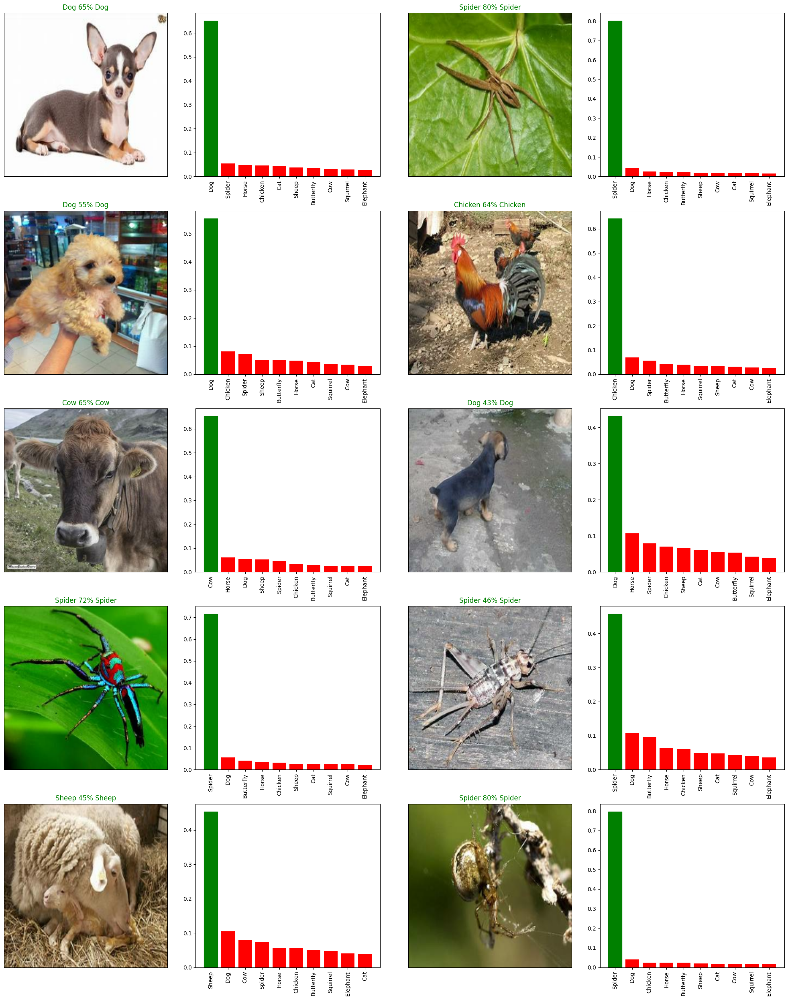

In [ ]:
multiplier = 60
num_rows = 5
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize = (10*num_cols, 5*num_rows))

for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities = test_predictions, labels = test_labels, images = test_images, n = i + multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_confidence(prediction_probabilities = test_predictions, labels = test_labels, n = i + multiplier)

plt.tight_layout(h_pad = 1.0)
plt.show()

## Making predictions on custom images
### To make predictions on custom images, we'll:

* Get the filepaths of our own images.
* Turn the filepaths into data batches using create_data_batches(). We will use custom_data here
* Pass the custom image data batch to our model's predict() method.
* Convert the prediction output probabilities to predictions labels.
* Compare the predicted labels to the custom images.

In [ ]:
custom_path = "drive/MyDrive/Animals/custom_images/"
custom_images_filenames = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
custom_images_filenames

['drive/MyDrive/Animals/custom_images/th (3).jpeg',
 'drive/MyDrive/Animals/custom_images/th (4).jpeg',
 'drive/MyDrive/Animals/custom_images/th (6).jpeg',
 'drive/MyDrive/Animals/custom_images/2831306.jpg',
 'drive/MyDrive/Animals/custom_images/th (7).jpeg',
 'drive/MyDrive/Animals/custom_images/th (1).jpeg',
 'drive/MyDrive/Animals/custom_images/th (5).jpeg',
 'drive/MyDrive/Animals/custom_images/OIP.jpeg',
 'drive/MyDrive/Animals/custom_images/th (2).jpeg',
 'drive/MyDrive/Animals/custom_images/th.jpeg']

In [ ]:
custom_data = create_data_batches(custom_images_filenames, custom_data = True)

Creating custom data batches.....


In [ ]:
custom_data

<_BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [ ]:
custom_pred = loaded_10000_img_model.predict(custom_data, verbose = 1)

1/1 [==============================] - 6s 6s/step


In [ ]:
custom_pred_labels = [get_pred_label(custom_pred[i]) for i in range(len(custom_pred))]
custom_pred_labels

['Spider',
 'Horse',
 'Butterfly',
 'Squirrel',
 'Cat',
 'Dog',
 'Chicken',
 'Elephant',
 'Cow',
 'Sheep']

### Let's visualize it with the help of image as well as the label together

In [ ]:
custom_images = []
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

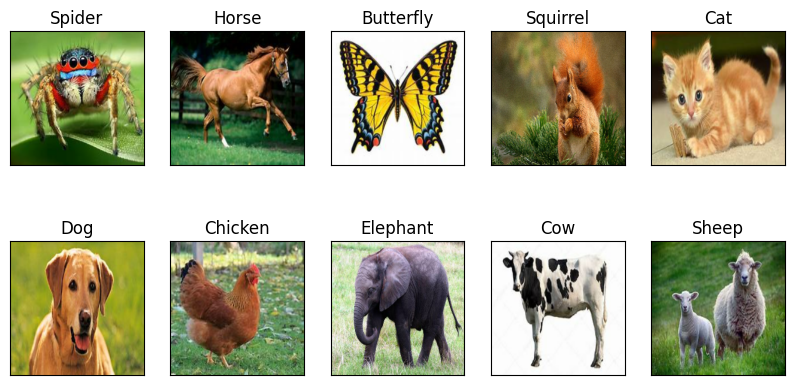

In [ ]:
plt.figure(figsize = (10, 5))
for i, image in enumerate(custom_images):
  plt.subplot(2, 5, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)



---

## ***CONCLUSION***

---



#### In conclusion, our animal classification model has demonstrated remarkable accuracy and efficiency in categorizing animal images across ten diverse categories: dog, cat, horse, spider, butterfly, chicken, sheep, cow, squirrel, and elephant. Leveraging a dataset of 26,179 images(trained on 10000 images out of 20943 train images) and utilizing advanced deep learning techniques, we have successfully trained a robust model capable of high precision in real-world applications.

#### The project involved meticulous data preprocessing, efficient model training using transfer learning with the ResNet-50 architecture, and thorough validation and testing to ensure the model's performance. The model achieved impressive accuracy, significantly reducing misclassification and enhancing our ability to identify animals accurately.

#### This classification system can be pivotal in various applications, including wildlife monitoring, veterinary diagnostics, and educational tools. Future enhancements could include expanding the dataset to incorporate more categories, fine-tuning the model for even higher accuracy, and deploying the model in real-time systems.

#### Overall, this project underscores the power of machine learning in solving complex image classification problems and sets the stage for further advancements in the field.


---



---



---


